In [17]:
import sys
sys.path.append('../')
import datetime as dt
from datetime import date, timedelta
import numpy as np
import pandas as pd
import plotly.express as px
import plotly.graph_objects as go
import matplotlib.pyplot as plt
import importlib
import json
import utils as u
importlib.reload(u)

<module 'utils' from '..\\utils.py'>

In [3]:
data = u.load_covid_static()
data.head()

c:\users\kehua\appdata\local\programs\python\python38\lib\site-packages\pandas\core\series.py:856: RuntimeWarning:

divide by zero encountered in log10



,FIPS,County Name,cases,deaths,log_cases,log_deaths
0,01001,Autauga County,25,1,1.397940,0.0
1,01003,Baldwin County,109,1,2.037426,0.0
2,01005,Barbour County,18,0,1.255273,0.0
3,01007,Bibb County,26,0,1.414973,0.0
4,01009,Blount County,20,0,1.301030,0.0


In [4]:
demographics = u.load_demographics_data()
demographics

,FIPS,total_pop,60plus,area,median_age,pop_white,pop_black,pop_hispanic
0,01001,55036,10523,594.44,37.8,76.9,19.1,2.8
1,01003,203360,53519,1589.78,42.8,86.3,9.5,4.5
2,01005,26201,6150,884.88,39.9,47.4,47.6,4.3
3,01007,22580,4773,622.58,39.9,76.7,22.3,2.4
4,01009,57667,13600,644.78,40.8,95.5,1.5,9.1
...,...,...,...,...,...,...,...,...
3137,56037,44527,7015,10426.65,34.6,93.1,0.8,16.0
3138,56039,22923,4298,3995.38,39.3,90.3,1.2,14.9
3139,56041,20758,3554,2081.26,35.5,93.4,0.1,9.1
3140,56043,8253,2206,2238.55,43.5,89.7,0.0,14.2


In [5]:
cases_per_pop = data['cases'].astype(int) / demographics['total_pop'].astype(int) * 10000
data['cases_per_pop'] = pd.Series(cases_per_pop, index=data.index)
data['logcases_per_pop'] = pd.Series(np.log10(cases_per_pop).replace([np.inf, -np.inf], 0), index=data.index)

data['deaths_per_pop'] = data['deaths'] / demographics['total_pop'] * 100000
data['logdeaths_per_pop'] = pd.Series(np.log10(data['deaths_per_pop'] ).replace([np.inf, -np.inf], 0), index=data.index)

demographics['pop_density'] = demographics['total_pop'] / demographics['area']
demographics['p60_plus'] = demographics['60plus'] / demographics['total_pop']

In [6]:
combined = pd.merge(data, demographics)

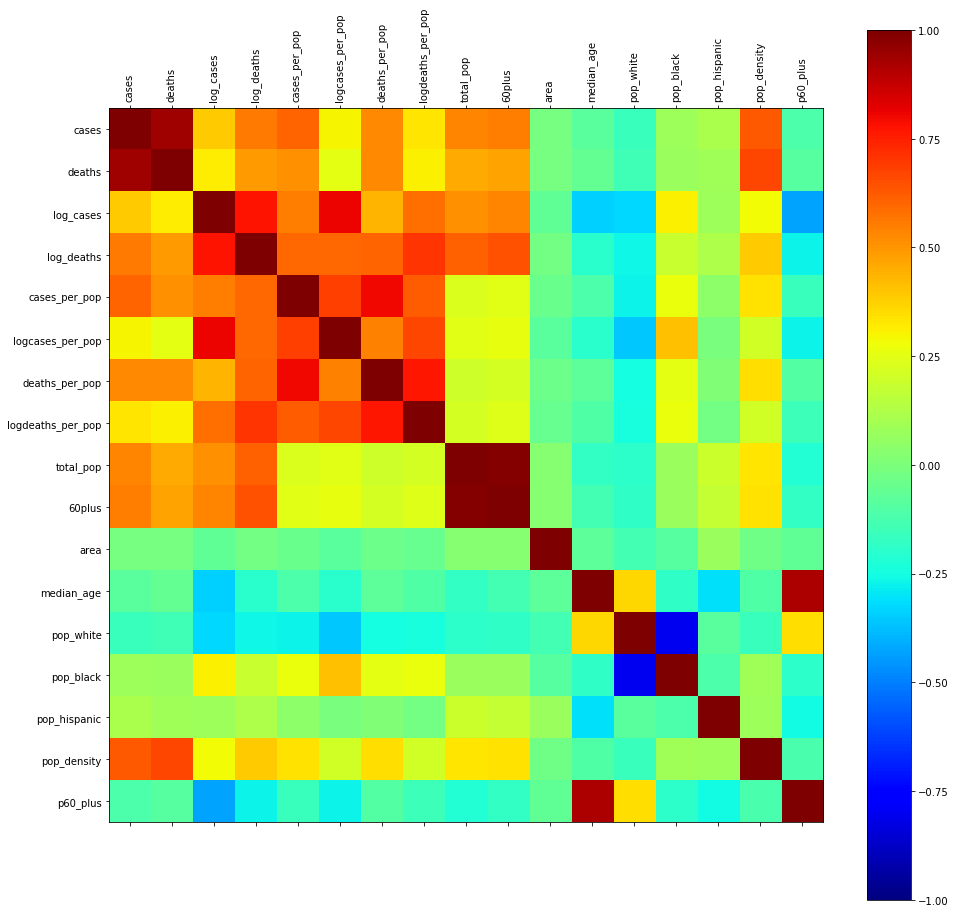

In [7]:
fig = plt.figure(figsize=(16, 16))
ax = fig.add_subplot(111)
a = ax.matshow(combined.corr(), cmap='jet', vmin=-1, vmax=1)
labels = combined.columns.tolist()[2:]
ax.set_xticklabels(labels,rotation=90, fontsize=10)
ax.set_xticks(np.arange(len(labels)))
ax.set_yticklabels(labels, fontsize=10)
ax.set_yticks(np.arange(len(labels)))
fig.colorbar(a)
plt.show()

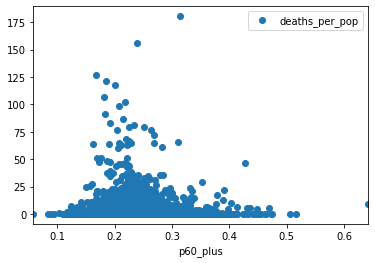

In [8]:
combined.plot(x='p60_plus', y='deaths_per_pop', style='o')

(3142, 84)


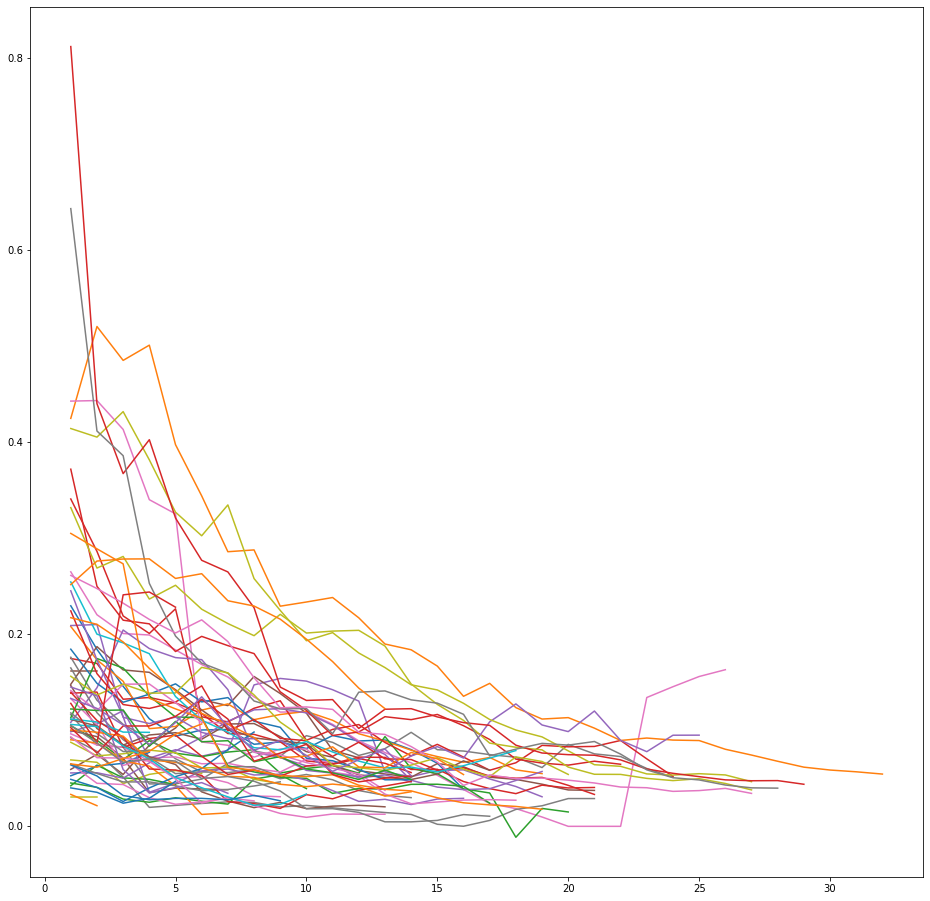

In [15]:
d = datadict['cases_pc_smoothed']
print(d.shape)
x = np.linspace(1, d.shape[1], d.shape[1])
fig = plt.figure(figsize=(16, 16))
ax = fig.add_subplot(111)
plt.plot(x, d[::10].T)
plt.show()

In [9]:
importlib.reload(u)
datadict = u.load_covid_timeseries()

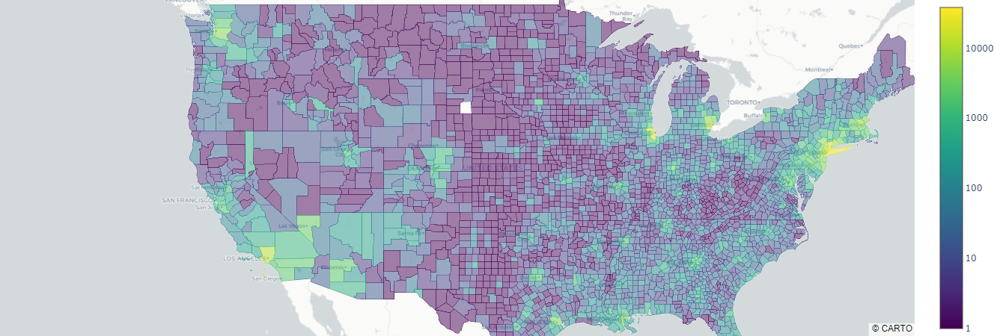

In [137]:
with open('geojson/geojson-counties-fips.json') as f:
    counties = json.load(f)
fig = go.Figure(go.Choroplethmapbox(geojson=counties, locations=data['FIPS'], z=data['log_cases'],
                                    colorscale="Viridis", zauto=True, customdata=data['cases'], text=data['County Name'],
                                    hovertemplate='<b>county:%{text}</b><br><b>cases:%{customdata}</b>',
                                    colorbar={'tickvals': [0, 1, 2, 3, 4, 5], 'ticktext': ['1', '10', '100', '1000', '10000', '100000']},
                                    marker_opacity=0.5, marker_line_width=0))
fig.update_layout(mapbox_style="carto-positron",
                  mapbox_zoom=3, mapbox_center = {"lat": 37.0902, "lon": -95.7129})
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

In [139]:
data.head()

,FIPS,County Name,cases,deaths,log_cases,log_deaths,cases_per_pop,logcases_per_pop,deaths_per_pop,logdeaths_per_pop
0,01001,Autauga County,25,1,1.397940,0.0,4.542481,0.657293,1.816993,0.259353
1,01003,Baldwin County,102,0,2.008600,0.0,5.015736,0.700335,0.000000,0.000000
2,01005,Barbour County,14,0,1.146128,0.0,5.343308,0.727810,0.000000,0.000000
3,01007,Bibb County,24,0,1.380211,0.0,10.628875,1.026487,0.000000,0.000000
4,01009,Blount County,18,0,1.255273,0.0,3.121369,0.494345,0.000000,0.000000


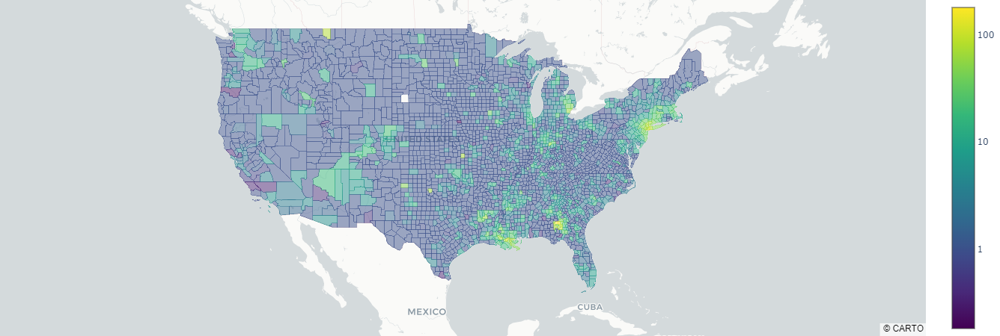

In [18]:
with open('geojson/geojson-counties-fips.json') as f:
    counties = json.load(f)
fig = go.Figure(go.Choroplethmapbox(geojson=counties, locations=data['FIPS'], z=data['logdeaths_per_pop'],
                                    colorscale="Viridis", zauto=True, customdata=data['deaths_per_pop'], text=data['County Name'],
                                    hovertemplate='<b>county:%{text}</b><br><b>deaths per 100000 pop:%{customdata: .3f}</b>',
                                    colorbar={'tickvals': [0, 1, 2, 3], 'ticktext': ['1', '10', '100', '1000']},
                                    marker_opacity=0.5, marker_line_width=0))
fig.update_layout(mapbox_style="carto-positron",
                  mapbox_zoom=3, mapbox_center = {"lat": 37.0902, "lon": -95.7129})
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

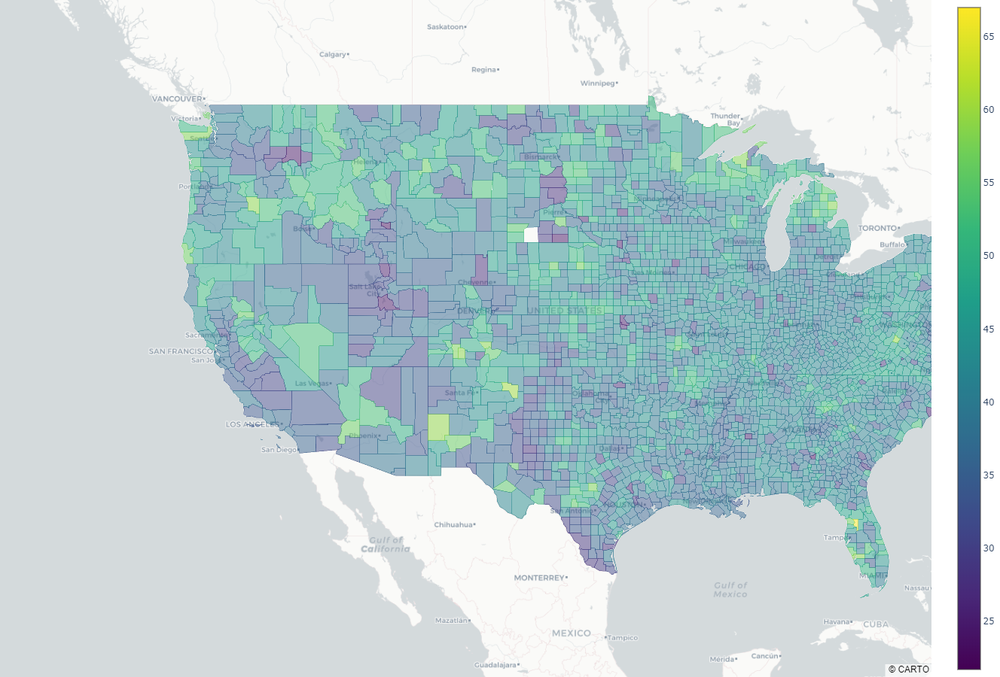

In [189]:
with open('geojson/geojson-counties-fips.json') as f:
    counties = json.load(f)
fig = go.Figure(go.Choroplethmapbox(geojson=counties, locations=demographics['FIPS'], z=demographics['median_age'],
                                    colorscale="Viridis", zauto=True, text=data['County Name'],
                                    hovertemplate='<b>county:%{text}</b><br><b>density:%{z}</b>',
                                    marker_opacity=0.5, marker_line_width=0))
fig.update_layout(mapbox_style="carto-positron",
                  mapbox_zoom=3, mapbox_center = {"lat": 37.0902, "lon": -95.7129})
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()